In [1]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all" # Allow multiple displays

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn_extra.cluster import KMedoids
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from yellowbrick.cluster import SilhouetteVisualizer


from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import KFold
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.metrics import f1_score

from sklearn.metrics.cluster import adjusted_rand_score

from varclushi import VarClusHi
from sklearn.preprocessing import scale

import plotly.express as px


from sklearn.cluster import AgglomerativeClustering
from yellowbrick.cluster import KElbowVisualizer

from fcmeans import FCM
from sklearn.cluster import DBSCAN

from sklearn.neighbors import NearestNeighbors

from sklearn.mixture import GaussianMixture as GMM

In [3]:
df = pd.read_csv('Data_Etudiants_2023.csv', sep=';')
df.head()

,T1_1h_R1,T1_2h_R1,T1_3h_R1,T1_4h_R1,T1_5h_R1,T1_6h_R1,T2_1h_R1,T2_2h_R1,T2_3h_R1,T2_4h_R1,...,T2_3h_R2,T2_4h_R2,T2_5h_R2,T2_6h_R2,T3_1h_R2,T3_2h_R2,T3_3h_R2,T3_4h_R2,T3_5h_R2,T3_6h_R2
G1,0.167009,0.682881,-0.180178,0.075348,-0.001642,0.501269,-0.590392,0.192059,0.815695,2.266757,...,0.263301,1.907773,2.466574,3.396958,0.696610,1.040833,0.810486,2.525922,3.268041,3.089573
G2,0.187621,0.815365,-0.045735,0.181518,0.467269,-0.759716,0.377821,2.510333,2.387657,2.998971,...,2.761253,2.440673,2.381917,2.260745,0.676540,2.443796,2.713063,2.867855,2.622922,2.051829
G3,-0.052076,-0.029437,0.261409,-0.317389,-0.386266,0.420686,0.208241,-0.998712,-2.583815,-3.372319,...,-1.769917,-3.323948,-2.632251,-2.877618,-0.281549,-1.292713,-1.913824,-3.886458,-3.129329,-3.110750
G4,-0.230785,-0.753947,-0.244923,-0.704300,-0.117073,-0.382628,0.409572,0.233312,0.967910,0.890278,...,1.024548,2.059611,1.737199,2.359006,0.094011,0.944675,0.404325,1.155446,1.890564,2.442747
G5,-0.205473,-0.688821,-0.181084,-0.066565,0.521709,0.448094,-0.449139,-1.514382,-3.815376,-2.503011,...,-2.398936,-2.551766,-2.474437,-3.144543,-0.619518,-2.706419,-2.828498,-2.849342,-2.938259,-3.390693


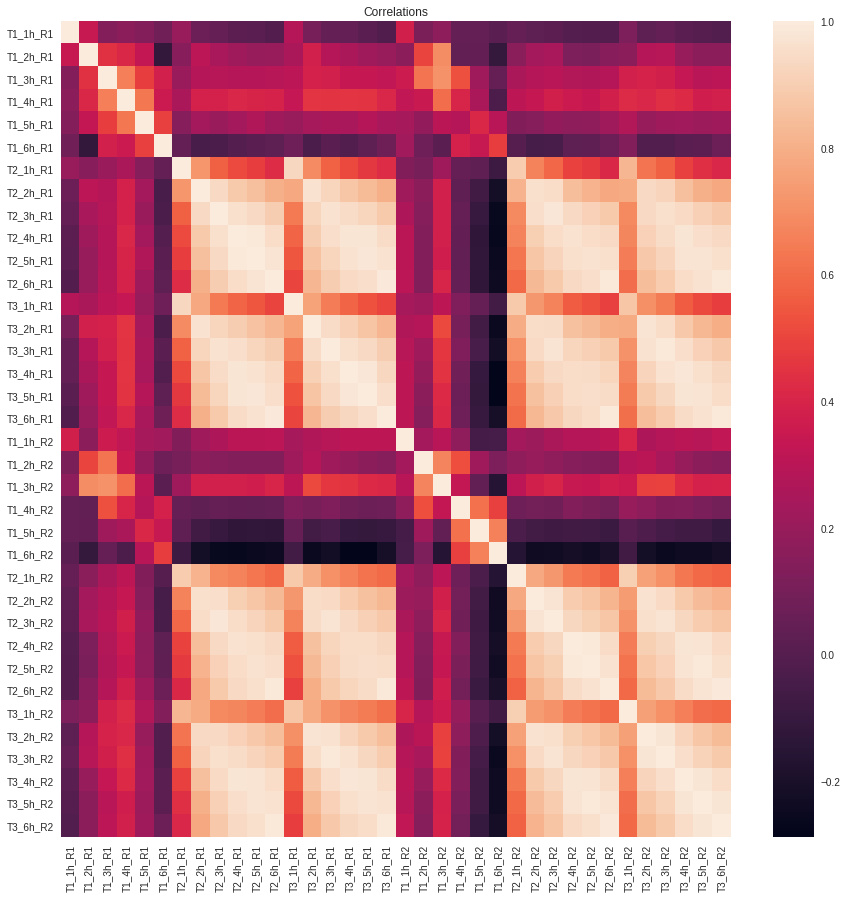

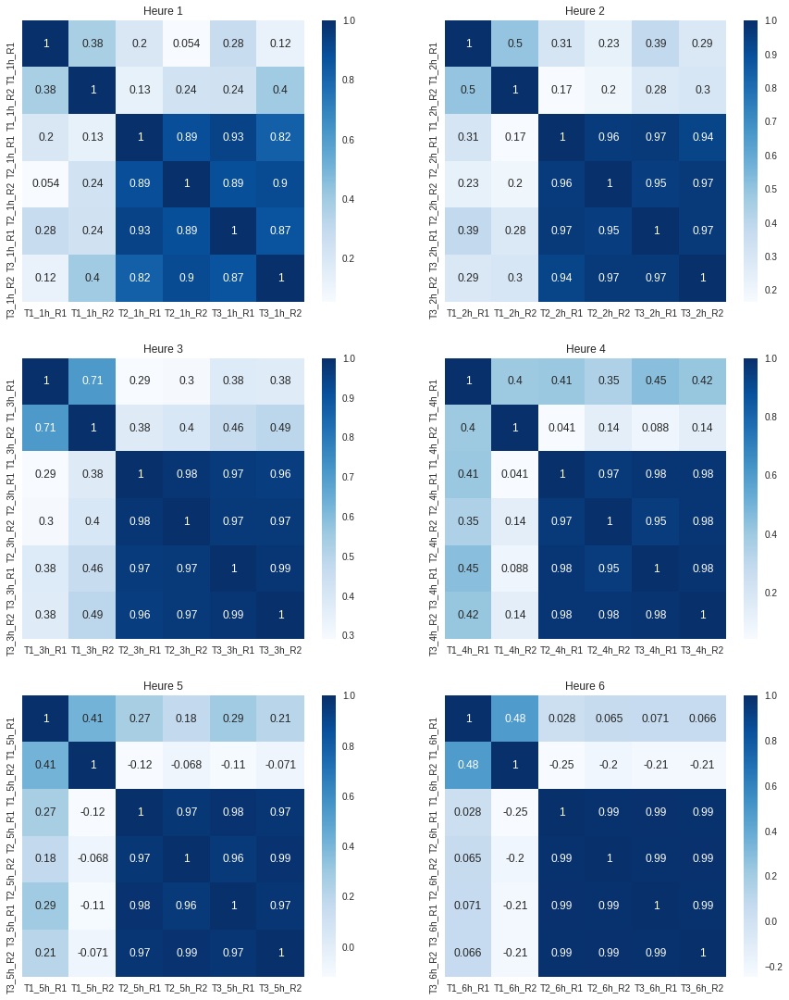

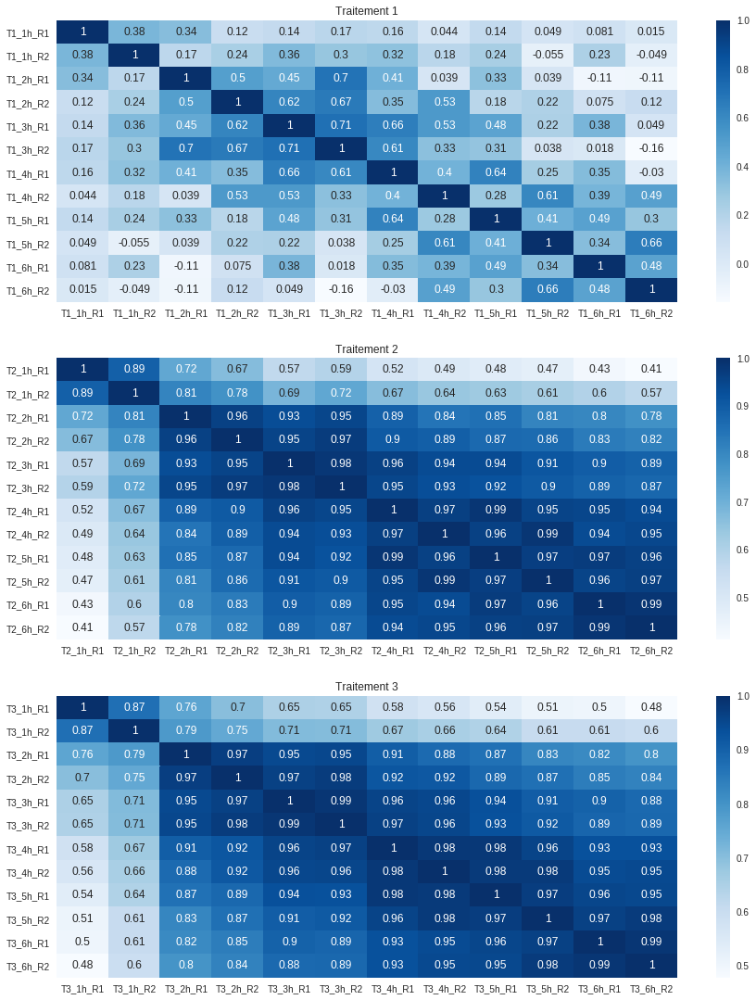

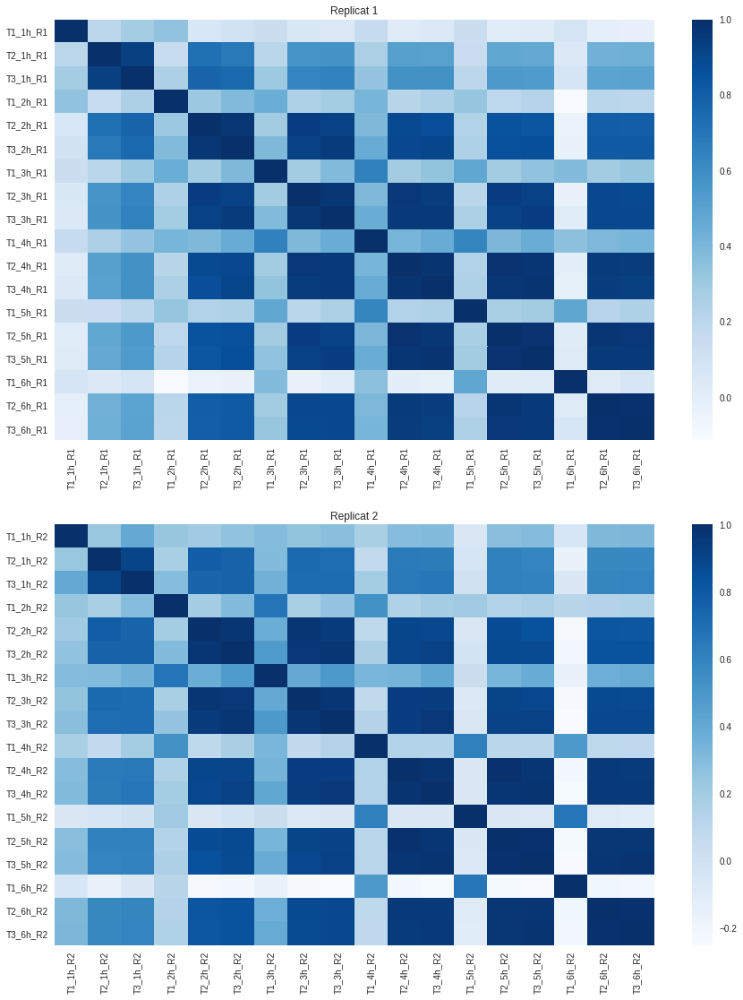

In [4]:
import seaborn as sns


fig, ax = plt.subplots(figsize=(15,15))  
ax.set_title("Correlations")
sns.heatmap(df.corr())

def prototype(x, y, z) :  # Retourne la chaîne de caractères 'Tx_yh_Rz'
    return "T"+str(x)+"_"+str(y)+"h_R"+str(z)
prototype(1,3,2)

def heure(k) : # Retourne toutes les  colonnes d'heure k
    X = []
    for i in range(1,4) : 
        for j in range(1,3):
            X.append(prototype(i, k, j))
    return X

def traitement(k) : # Retourne toutes les   colonnes de traitement k
    X = []
    for i in range(1,7) : 
        for j in range(1,3):
            X.append(prototype(k, i, j))
    return X

def replicat(k) : # Retourne toutes les   colonnes de replicat k
    X = []
    for i in range(1,7) : 
        for j in range(1,4):
            X.append(prototype(j, i, k))
    return X

def intersection(lst1, lst2):
    return sorted(list(set(lst1) & set(lst2)))

intersection(replicat(1), traitement(2))

heure1 = df.loc[:,heure(1)]
heure2 = df.loc[:,heure(2)]
heure3 = df.loc[:,heure(3)]
heure4 = df.loc[:,heure(4)]
heure5 = df.loc[:,heure(5)]
heure6 = df.loc[:,heure(6)]

traitement1=df.loc[:,traitement(1)]
traitement2=df.loc[:,traitement(2)]
traitement3=df.loc[:,traitement(3)]

replicat1=df.loc[:,replicat(1)]
replicat2=df.loc[:,replicat(2)]

fig, ax = plt.subplots(figsize=(15,19), ncols=2, nrows=3)  
sns.heatmap(heure1.corr(),cmap="Blues", annot=True, ax=ax[0][0]);
sns.heatmap(heure2.corr(),cmap="Blues", annot=True, ax=ax[0][1]);
sns.heatmap(heure3.corr(),cmap="Blues", annot=True, ax=ax[1][0]);
sns.heatmap(heure4.corr(),cmap="Blues", annot=True, ax=ax[1][1]);
sns.heatmap(heure5.corr(),cmap="Blues", annot=True, ax=ax[2][0]);
sns.heatmap(heure6.corr(),cmap="Blues", annot=True, ax=ax[2][1]);
ax[0][0].set_title("Heure 1");
ax[0][1].set_title("Heure 2");
ax[1][0].set_title("Heure 3");
ax[1][1].set_title("Heure 4");
ax[2][0].set_title("Heure 5");
ax[2][1].set_title("Heure 6");

fig, ax = plt.subplots(figsize=(15,19),  nrows=3)  
sns.heatmap(traitement1.corr(),cmap="Blues", annot=True,ax=ax[0]);
ax[0].set_title("Traitement 1");
sns.heatmap(traitement2.corr(),cmap="Blues", annot=True, ax=ax[1]);
ax[1].set_title("Traitement 2");
sns.heatmap(traitement3.corr(),cmap="Blues", annot=True, ax=ax[2]);
ax[2].set_title("Traitement 3");


fig, ax = plt.subplots(figsize=(15,19),  nrows=2)  
sns.heatmap(replicat1.corr(),cmap="Blues", ax=ax[0]);
ax[0].set_title("Replicat 1");
sns.heatmap(replicat2.corr(),cmap="Blues", ax=ax[1]);
ax[1].set_title("Replicat 2");

Remarque : les traitements 2 et 3 à 1h semblement être mieux correlés avec eux-mêmes qu'avec les autres heures des memes traitements.

In [5]:
df_scaled = scale(df) # Données centrées réduites 
df_scaled = pd.DataFrame(df_scaled)
df_scaled.columns=df.columns
df_scaled.index=df.index
fig = px.box(df_scaled, title="Boxplot des données réduites.")
fig.show()

fig=px.violin(df_scaled, title="Violinplot des données réduites.")
fig.show()

In [6]:
mypca = PCA(n_components=3);
mypca.fit(df);
dataPCA=mypca.fit_transform(df_scaled)

pca_df = pd.DataFrame({
    "Dim1" : dataPCA[:,0], 
    "Dim2" : dataPCA[:,1],
    "Dim3" : dataPCA[:,2]
})
pca_df.index = df.index

PCA(n_components=3)

In [7]:
fig=px.scatter(pca_df,x="Dim1", y="Dim2", title="Données projetées sur les deux premiers axes principaux.")
fig.show()

In [8]:
fig=px.scatter_3d(pca_df,x="Dim1", y="Dim2", z="Dim3", title="Données projetées sur les 3 premiers axes principaux.")
fig.show()

Nous pouvons globalement distinguer deux clusters de gênes.

# 1 - Clustering des données (gènes) : 

/home/n7student/anaconda3/lib/python3.7/site-packages/seaborn/matrix.py:649: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.



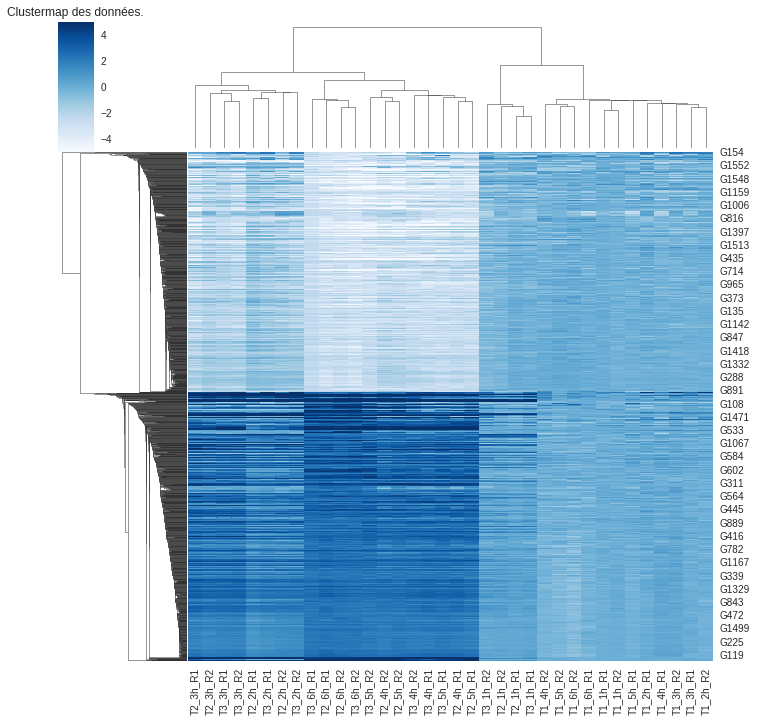

In [9]:
g = sns.clustermap(df, method="single", vmin=-5, vmax=5, cmap="Blues")
plt.title("Clustermap des données.");

Le clustermap regroupe les données et les variables dans des clusters, en utilisant la distance euclidienne et la mesure d'agrégation single. D'après la structure du dendogramme, nous constatons deux clusters pour les données,3 pour les variables. Le but dans ce jupyter notebook est de confirmer ces clusters ou d'en proposer d'autres, via les différentes méthodes de classifications vues en cours.

## a) Kmeans, Kmedians & Fuzzy Cmeans : 

###  &emsp;  Kmeans

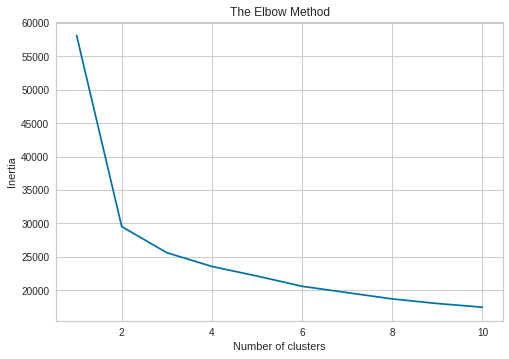

In [10]:
wcss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters = i, init = 'k-means++')
    #kmeans = KMeans(n_clusters = i, init = 'k-means++', random_state = 42)
    kmeans.fit(df_scaled)
    wcss.append(kmeans.inertia_)

plt.figure();
plt.plot(range(1, 11), wcss);
plt.title('The Elbow Method');
plt.xlabel('Number of clusters');
plt.ylabel('Inertia');
plt.show();

In [11]:
silhouette_coefficients = []
for k in range(2, 11):
  kmeans = KMeans(n_clusters=k,init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0);
  kmeans.fit(df);
  score = silhouette_score(df_scaled, kmeans.labels_);
  silhouette_coefficients.append(score);

aux = pd.DataFrame({"K" : range(2, 11),
                    "Silhouette" : silhouette_coefficients})
fig = px.line(aux, x='K', y='Silhouette',labels={'x':'Number of clusters', 'y':'Silhouette'},title="Silhouette score", markers=True);
fig.show() ;

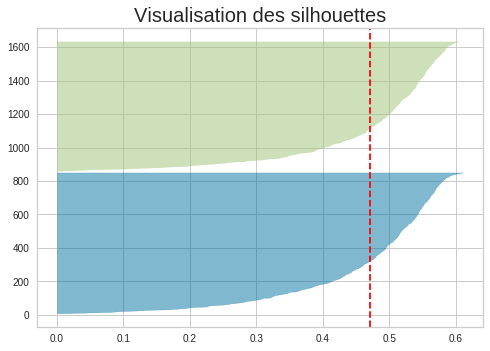

In [12]:
from yellowbrick.cluster import SilhouetteVisualizer
kmeansopt = KMeans(2,init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0);
visualizer = SilhouetteVisualizer(kmeansopt, colors='yellowbrick');
visualizer.fit(df_scaled) ;
plt.title("Visualisation des silhouettes", size=20);

On retient K=2 pour la méthode des Kmeans, les 2 critères (Elbow & silhouette) suggèrent cette valeur de K.

In [13]:
kmeans = KMeans(n_clusters=2).fit(df_scaled)

kmeans_df = pd.DataFrame({
    "Dim1" : dataPCA[:,0], 
    "Dim2" : dataPCA[:,1],
    "Kmeans2" : pd.Categorical(kmeans.labels_)
})

fig=px.scatter(kmeans_df,x="Dim1",y="Dim2",color="Kmeans2", title="Visualisation des gènes labelisés avec la méthode des Kmeans.")
fig.show()

###  &emsp;  Kmedoids

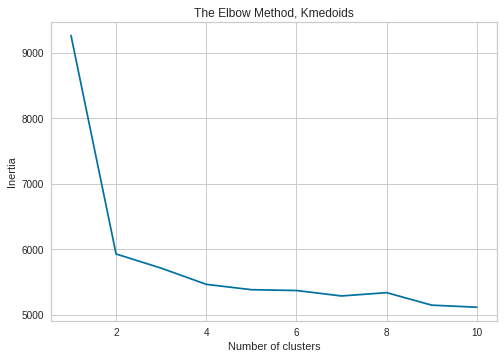

In [14]:
wcss = []
for i in range(1, 11):
    #kmeans = KMeans(n_clusters = i, init = 'k-means++', random_state = 42)
    kmedoids = KMedoids(n_clusters=i).fit(df_scaled)
    wcss.append(kmedoids.inertia_)

plt.figure();
plt.plot(range(1, 11), wcss);
plt.title('The Elbow Method, Kmedoids');
plt.xlabel('Number of clusters');
plt.ylabel('Inertia');
plt.show();

On retient K=2 pour Kmedoids aussi.

In [15]:
kmedoids = KMedoids(n_clusters=2).fit(df_scaled)

kmedoids_df = pd.DataFrame({
    "Dim1" : dataPCA[:,0], 
    "Dim2" : dataPCA[:,1],
    "Kmedoids2" : pd.Categorical(kmedoids.labels_)
})

fig=px.scatter(kmedoids_df,x="Dim1",y="Dim2",color="Kmedoids2", title="Visualisation des gènes labelisés avec la méthode des Kmedoids.")
fig.show()

In [16]:
pd.crosstab(kmedoids.labels_,kmeans.labels_)
print("Adjusted rand score kmeans & kmedoids : ", adjusted_rand_score(kmeans.labels_,kmedoids.labels_))


col_0,0,1
row_0,,
0,767,1
1,6,841


Adjusted rand score kmeans & kmedoids :  0.9827269532304379


Excellente concordance entre les deux méthodes de classifications.

###  &emsp;  Fuzzy C-means : 

In [17]:
from fcmeans import FCM
fcmmodel=FCM(n_clusters=2)
fcmmodel.fit(df_scaled.to_numpy())

centers = fcmmodel.centers
labels_fcm = fcmmodel.predict(df.to_numpy())
poids=fcmmodel.u


fcm_df=pd.DataFrame({'label':list(map(str,labels_fcm)), 'probamax':np.amax(poids, axis=1)})
fig=px.box(fcm_df,x='label',y='probamax')
fig.show()

# Plot dans le premier plan factoriel
fcm_df = pd.DataFrame({
    "Dim1" : dataPCA[:,0], 
    "Dim2" : dataPCA[:,1],
    "fcmeans" : pd.Categorical(fcm_df.label),
    "probamax" : fcm_df.probamax
})

fig=px.scatter(fcm_df,x="Dim1", y="Dim2", color= "fcmeans", title="Visualisation des gènes labelisés avec la méthode fuzzy C-means.")
fig.show()

In [18]:
print("Adjusted rand score kmeans & fuzzy C-means : ", adjusted_rand_score(kmeans.labels_,labels_fcm))


Adjusted rand score kmeans & fuzzy C-means :  0.9778194191535847


#### Les 3 méthodes donnent des résultats cohérents. On peut donc pour la suite considérer que la valeur K=2 est fiable.

## b) Classification hierarchique & DBSCAN : 

###  &emsp;  DBSCAN 

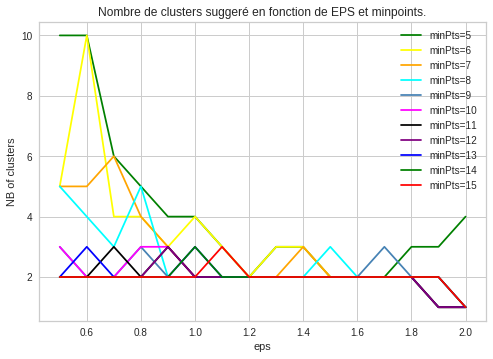

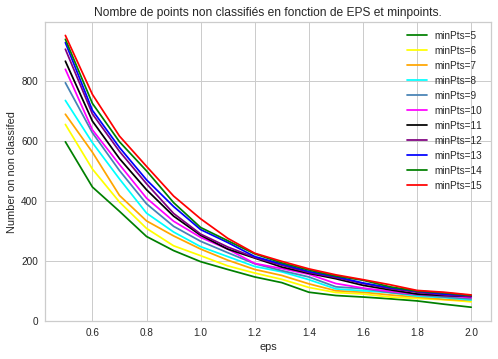

In [19]:
# Calibration des paramètres DBSCAN : 
epsvalue= np.arange(0.5, 2.1, 0.1)
minPtsvalue=np.arange(5, 16,1)
NBCluster = np.zeros((minPtsvalue.size,epsvalue.size))
NBNonCl=np.zeros((minPtsvalue.size,epsvalue.size))

for i in np.arange(0,minPtsvalue.size,1):
    for j in np.arange(0,epsvalue.size,1):
        resdbsc = DBSCAN(eps=epsvalue[j],min_samples=minPtsvalue[i]).fit(pca_df)
        NBCluster[i,j] = len(np.unique(resdbsc.labels_))-1
        NBNonCl[i,j] = np.count_nonzero(resdbsc.labels_==-1)
    
# 
plt.plot(epsvalue,NBCluster[0,:], label='minPts=5', color='green');
plt.plot(epsvalue,NBCluster[1,:], label='minPts=6', color='yellow');
plt.plot(epsvalue,NBCluster[2,:], label='minPts=7', color='orange');
plt.plot(epsvalue,NBCluster[3,:], label='minPts=8', color='cyan');
plt.plot(epsvalue,NBCluster[4,:], label='minPts=9', color='steelblue');
plt.plot(epsvalue,NBCluster[5,:], label='minPts=10', color='magenta');
plt.plot(epsvalue,NBCluster[6,:], label='minPts=11', color='black');
plt.plot(epsvalue,NBCluster[7,:], label='minPts=12', color='purple');
plt.plot(epsvalue,NBCluster[8,:], label='minPts=13', color='blue');
plt.plot(epsvalue,NBCluster[9,:], label='minPts=14', color='green');
plt.plot(epsvalue,NBCluster[10,:], label='minPts=15', color='red');
plt.xlabel("eps");
plt.ylabel("NB of clusters");
plt.legend();
plt.title("Nombre de clusters suggeré en fonction de EPS et minpoints.")
plt.show();
plt.close();

#    
plt.plot(epsvalue,NBNonCl[0,:], label='minPts=5', color='green');
plt.plot(epsvalue,NBNonCl[1,:], label='minPts=6', color='yellow');
plt.plot(epsvalue,NBNonCl[2,:], label='minPts=7', color='orange');
plt.plot(epsvalue,NBNonCl[3,:], label='minPts=8', color='cyan');
plt.plot(epsvalue,NBNonCl[4,:], label='minPts=9', color='steelblue');
plt.plot(epsvalue,NBNonCl[5,:], label='minPts=10', color='magenta');
plt.plot(epsvalue,NBNonCl[6,:], label='minPts=11', color='black');
plt.plot(epsvalue,NBNonCl[7,:], label='minPts=12', color='purple');
plt.plot(epsvalue,NBNonCl[8,:], label='minPts=13', color='blue');
plt.plot(epsvalue,NBNonCl[9,:], label='minPts=14', color='green');
plt.plot(epsvalue,NBNonCl[10,:], label='minPts=15', color='red');

#plt.plot(epsvalue,NBNonCl[0,:], label='minPts=5', color='green')
#plt.plot(epsvalue,NBNonCl[4,:], label='minPts=9', color='steelblue')
#plt.plot(epsvalue,NBNonCl[7,:], label='minPts=12', color='purple')
#plt.plot(epsvalue,NBNonCl[10,:], label='minPts=15', color='red')
plt.xlabel("eps");
plt.ylabel("Number on non classifed");
plt.legend();
plt.title("Nombre de points non classifiés en fonction de EPS et minpoints.")
plt.show();

Text(0, 0.5, 'k-NN distance')

Text(0.5, 0, 'Points triés par ordre de distance croissant')

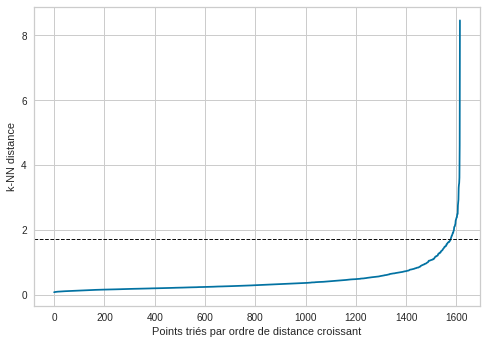

In [20]:
neighbors = NearestNeighbors(n_neighbors=5)
neighbors_fit = neighbors.fit(pca_df)
distances, indices = neighbors_fit.kneighbors()
distancesmean = np.sort(distances.sum(axis=1)/7,axis=0)

plt.plot(distancesmean)
plt.axhline(y=1.7, linewidth=1, linestyle='dashed', color='k')
plt.ylabel("k-NN distance")
plt.xlabel("Points triés par ordre de distance croissant")
plt.show()

#dbscopt = DBSCAN(eps=...., min_samples=....).fit(winequant)
#pd.crosstab(dbscopt.labels_,"freq")

In [21]:
dbscan = DBSCAN(eps=1.7, min_samples=5).fit(pca_df)
pd.crosstab(dbscan.labels_,"freq")

col_0,freq
row_0,
-1,73
0,789
1,753


On retient 2 clusters, avec une valeur du rayon de 1.7, et un nombre minimum de voisin de 5, on obtient une classification et 73 points non labélisés, ce qui constitue moins de 5% du nombre total des gènes à classifier. La présence de points non classifiés est dû à la nature de l'algorithme DBSCAN, il est basé sur la densité. Or, force est de constater la présence de quelques points dispersés des deux clusters : ce sont les points non classés par l'algorithme DBSCAN.

In [22]:
dbscan_df = pd.DataFrame({
    "Dim1" : pca_df["Dim1"], 
    "Dim2" : pca_df["Dim2"],
    "dbscan" : pd.Categorical(dbscan.labels_)
})

fig=px.scatter(dbscan_df,x="Dim1",y="Dim2",color="dbscan", title="Visualisation des gènes labelisés avec la méthode DBSCAN, la classe -1 représente les points non classés.")
fig.show()

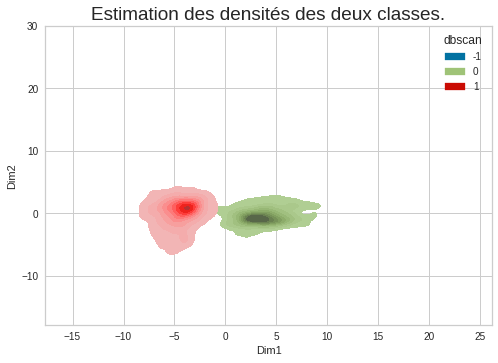

In [23]:
sns.kdeplot(data=dbscan_df, x="Dim1", y="Dim2", hue="dbscan", fill=True);
plt.title("Estimation des densités des deux classes.", size=19);

La fonction kdeplot (kernel density estimation) affiche l'estimation de la distribution des données des deux classes. On peut voir qu'elle n'estime pas la densité des points non classés car ils sont très dispersés. Pour classifier ces points, une méthode consisterait à assignait chaque point non classifié à une classe par un algorithme d'apprentissage surperivsé (K-nearest neighbors, Support vector machine par exemple), en prenant comme labels ceux prédits par la méthode non supervisée DBSCAN. (?)

In [24]:
print("Adjusted rand score kmeans & DBSCAN : ", adjusted_rand_score(kmeans.labels_,dbscan.labels_))


Adjusted rand score kmeans & DBSCAN :  0.8996545931247699


Considérons un classifieur qui va attribuer au hasard une classe (0 ou 1) au points non classés (le pire classifieur possible ?), on n'aura pas (en moyenne)  une diminution du adjusted rand score entre Kmeans & DBSCAN modifié par cet classifieur : 

In [25]:
score_moyen = []
for j in range(5000) : 
    lab2 = dbscan.labels_.copy()
    for i in range(len(lab2)) : 
        if lab2[i] == -1 : 
            lab2[i] = np.random.randint(0,2)
    score_moyen.append(adjusted_rand_score(kmeans.labels_, lab2))

Au bout de 5000 calcul de ce adjusted rand score, on obtient une moyenne de : 

In [26]:
np.mean(score_moyen)

0.8997787474123384

In [27]:
np.mean(score_moyen) - adjusted_rand_score(kmeans.labels_,dbscan.labels_) > 0 

True

Qui est supérieur score du DBSCAN de base. Cela est du au fait que le DBSCAN va pénaliser le fait d'avoir un nombre différent de classes pour les deux classifeurs qu'on souhaite comparer, ce qui encourage de mettre les points non classés dans un cluster via un algorithme de classification supervisé. Il suffit de prendre un meilleur algorithme que l'algorithme considéré pour l'exemple..

###  &emsp;  Classification hierarchique  

KElbowVisualizer(ax=<matplotlib.axes._subplots.AxesSubplot object at 0x7fda1d0c6450>,
                 estimator=AgglomerativeClustering(n_clusters=10), k=(2, 11),
                 metric='calinski_harabasz')

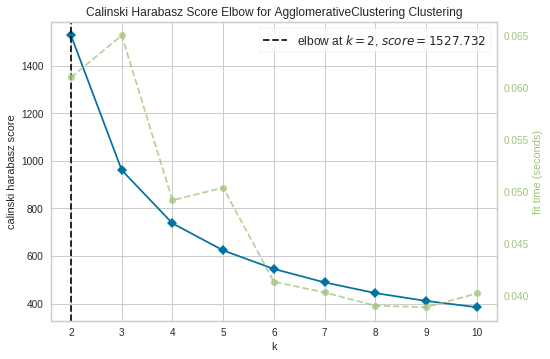

In [28]:
from yellowbrick.cluster import KElbowVisualizer
model = AgglomerativeClustering(linkage="ward")
visualizer = KElbowVisualizer(model, k=(2,11),  metric='calinski_harabasz');
visualizer.fit(df_scaled)
visualizer.show()

KElbowVisualizer(ax=<matplotlib.axes._subplots.AxesSubplot object at 0x7fda1cdd8c50>,
                 estimator=AgglomerativeClustering(linkage='complete',
                                                   n_clusters=10),
                 k=(2, 11), metric='calinski_harabasz')

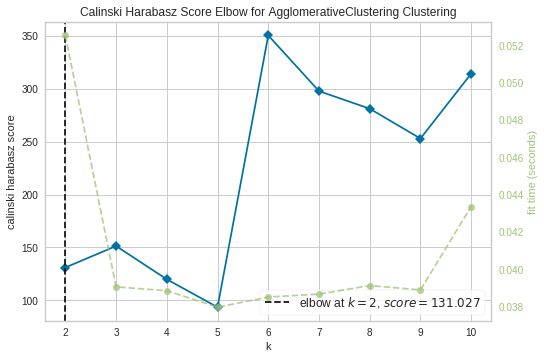

In [29]:
from yellowbrick.cluster import KElbowVisualizer
model = AgglomerativeClustering(linkage="complete")
visualizer = KElbowVisualizer(model, k=(2,11),  metric='calinski_harabasz');
visualizer.fit(df_scaled)
visualizer.show()

KElbowVisualizer(ax=<matplotlib.axes._subplots.AxesSubplot object at 0x7fda1ccfde90>,
                 estimator=AgglomerativeClustering(linkage='average',
                                                   n_clusters=10),
                 k=(2, 11), metric='calinski_harabasz')

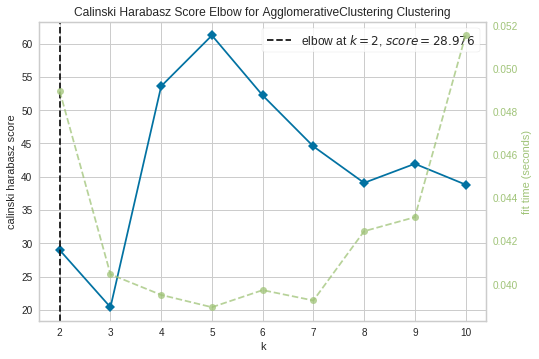

In [30]:
from yellowbrick.cluster import KElbowVisualizer
model = AgglomerativeClustering(linkage="average")
visualizer = KElbowVisualizer(model, k=(2,11),  metric='calinski_harabasz');
visualizer.fit(df_scaled)
visualizer.show()

KElbowVisualizer(ax=<matplotlib.axes._subplots.AxesSubplot object at 0x7fda1cd3bad0>,
                 estimator=AgglomerativeClustering(linkage='single',
                                                   n_clusters=10),
                 k=(2, 11), metric='calinski_harabasz')

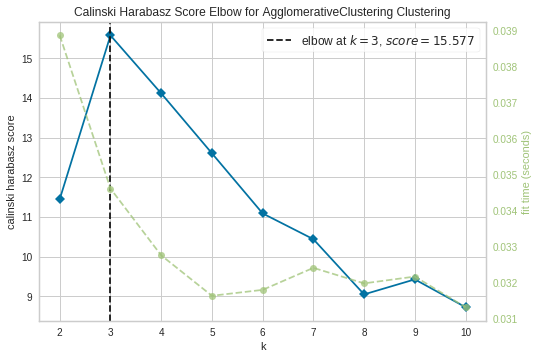

In [31]:
from yellowbrick.cluster import KElbowVisualizer
model = AgglomerativeClustering(linkage="single")
visualizer = KElbowVisualizer(model, k=(2,11),  metric='calinski_harabasz');
visualizer.fit(df_scaled)
visualizer.show()

La mesure d'agrégation Ward est adapté à nos données car elle tend à créer des classes de même effectif, ce qui est notre cas. La classification hierarchique avec la mesure d'agrégation Ward donne le meilleur score pour k=2 classes. On retient cette mesure et ce nombre de classes.

In [32]:
from sklearn.cluster import AgglomerativeClustering # Mesure d'agréagation : Ward
hierarchical_cluster = AgglomerativeClustering(n_clusters=2,linkage="ward")
Clustk2 = hierarchical_cluster.fit_predict(df_scaled)

In [33]:
np.unique(Clustk2, return_counts = True ) 

(array([0, 1]), array([856, 759]))

In [34]:
hclust_df = pd.DataFrame({
    "Dim1" : pca_df["Dim1"], 
    "Dim2" : pca_df["Dim2"],
    "hc2" : pd.Categorical(Clustk2)
})

fig=px.scatter(hclust_df,x="Dim1",y="Dim2",color="hc2",symbol="hc2")
fig.show()

In [35]:
adjusted_rand_score(kmeans.labels_, Clustk2)

0.9558873728867143

Très bon score avec Kmeans.

###  &emsp;  Mélanges gaussiens

In [36]:
K_components = np.arange(2,11)
models = [GMM(K, covariance_type="diag", random_state=0).fit(df) for K in K_components] # covariance = tied

In [37]:
crit = pd.DataFrame({
    "K" : np.arange(2, 11),
    "BIC" : [m.bic(df) for m in models], 
    "AIC" : [m.aic(df) for m in models],
})
critdf=pd.melt(crit, id_vars=['K'], value_vars=['BIC', 'AIC'])

fig = px.line(critdf, x='K', y='value', color='variable', title="Valeur des critères BIC & AIC en fonction des nombres de classes pour les mélanges gaussiens.")
fig.show()

La valeur de K qui minimise le critère est K=10. Cependant, nous avons vu (code R) que le clustering GMM avec K=10 ne donnait pas de bons résultats.

Nous avons évoqué en classe des stratégies de fusion de classes dans le cas où les mélanges gaussiens donnaient un grand nombre de classes.

D'après le graphe, la valeur de K=3 diminue sensiblement les critères. Il s'agit d'un coude des deux courbes. On explore un mélange Gaussien avec K=3.

In [38]:
probapost = models[1].predict_proba(df)
labels=models[1].fit_predict(df)   
probamax=[np.max(probapost[x,:]) for x in range(len(df))]

#pd.crosstab(labels,"freq")

GMMM = pd.DataFrame({
    "X" : pca_df.Dim1, 
    "Y" : pca_df.Dim2,
    "labels" : pd.Categorical(labels)
})

import plotly.express as px
fig = px.scatter(GMMM,x="X", y="Y", color="labels", symbol="labels", title="Nuages de points des points labélisés par mélanges gaussiens.")
fig.show()


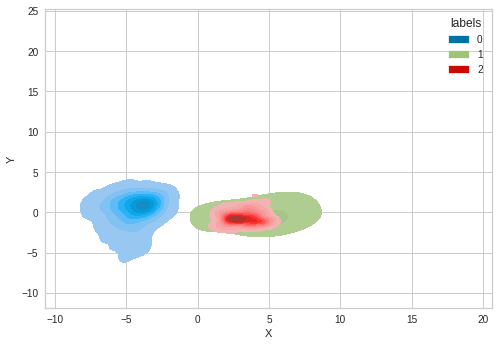

In [39]:
sns.kdeplot(data=GMMM, x="X", y="Y", hue="labels", fill=True)

Traitement à posteriori : fusionner les deux classes 1 et 2.
Justification : On voit clairement que la densité de distribution de la classe 2 est englobée par celle de la classe 1. 

In [40]:
# boxplot des probamax
aux=pd.DataFrame({'probamax':probamax,'labels':labels},columns = ['probamax', 'labels'])

import plotly.express as px
fig = px.box(aux, x="labels", y="probamax", title="Probabilités d'appartenance aux classes, K=3 classes")
fig.show()

In [41]:
probapost2 = models[0].predict_proba(df)
labels2=models[0].fit_predict(df)   
probamax2=[np.max(probapost[x,:]) for x in range(len(df))]

pd.crosstab(labels2,"freq")

col_0,freq
row_0,
0,764
1,851


In [42]:
GMMM2 = pd.DataFrame({
    "X" : pca_df.Dim1, 
    "Y" : pca_df.Dim2,
    "labels" : pd.Categorical(labels2)
})

import plotly.express as px
fig = px.scatter(GMMM2,x="X", y="Y", color="labels", symbol="labels", title="Visualisation nuage des données labélisés par mélanges gaussiens, K=2 classes")
fig.show()

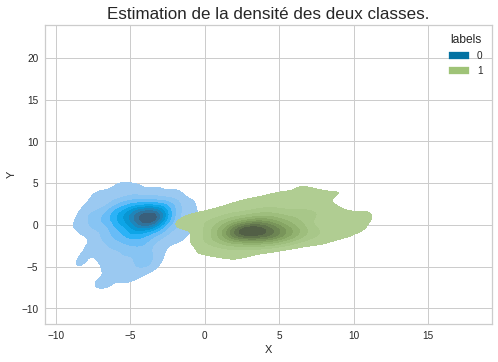

In [43]:
sns.kdeplot(data=GMMM2, x="X", y="Y", hue="labels", fill=True);
plt.title("Estimation de la densité des deux classes.", size=17);
# boxplot des probamax
aux=pd.DataFrame({'probamax':probamax2,'labels':labels2},columns = ['probamax', 'labels'])

fig = px.box(aux, x="labels", y="probamax", title="Probabilités d'appartenance aux classes, K=2.");
fig.show();

Interpretation  : 

La classe 1 reste stable à 100%. La fusion des deux classes (2 & 3) n'empire pas les probabilités d'appartenance : on remarque que le boxplot résultant n'est rien d'autre que la superposition des deux boxplots obtenus précédemment pour les deux classes en questions. Nous pouvons donc retenir le choix de K=2 pour les mélanges gaussiens.

#### Comparaison Kmeans & GMM avec k=2 classes : 

In [44]:
adjusted_rand_score(labels2, kmeans.labels_ )

0.9631704533245365

Perfect.

## Interpretation des clusters (Kmeans) : 

In [45]:
df['class'] = kmeans.labels_.astype(int)
clusters = df.groupby('class').mean()
clusters

,T1_1h_R1,T1_2h_R1,T1_3h_R1,T1_4h_R1,T1_5h_R1,T1_6h_R1,T2_1h_R1,T2_2h_R1,T2_3h_R1,T2_4h_R1,...,T2_3h_R2,T2_4h_R2,T2_5h_R2,T2_6h_R2,T3_1h_R2,T3_2h_R2,T3_3h_R2,T3_4h_R2,T3_5h_R2,T3_6h_R2
class,,,,,,,,,,,,,,,,,,,,,
0,-0.026931,-0.067935,-0.210950,-0.251506,-0.210245,-0.129476,-0.202623,-1.104274,-2.349011,-2.633211,...,-1.760330,-2.595361,-2.679905,-2.966133,-0.578459,-1.705991,-2.192853,-2.695394,-2.992842,-3.270738
1,-0.017883,0.183862,0.104808,0.265494,0.023459,-0.125219,0.515283,1.868190,2.703766,2.765181,...,2.514593,2.666296,2.800199,3.006995,0.682697,2.184958,2.644712,2.773370,2.924930,3.021759


In [46]:
clusters_T1 = clusters.loc[:,clusters.columns.str.startswith('T1')]
clusters_T2 = clusters.loc[:,clusters.columns.str.startswith('T2')]
clusters_T3 = clusters.loc[:,clusters.columns.str.startswith('T3')]

In [47]:
Clusters_1h = clusters.loc[:,clusters.columns.str.contains('1h')]

In [48]:
px.line(clusters_T1.T, title="Moyenne d'expression des gènes, traitement 1")
fig_2 = px.line(clusters_T2.T, title="Moyenne d'expression des gènes, traitement 2")
fig_2.add_hline(y=0.6, line_width=1.5, line_dash="dash", line_color="green")
fig_3 = px.line(clusters_T3.T, title="Moyenne d'expression des gènes, traitement 3")
fig_3.add_hline(y=0.6, line_width=1.5, line_dash="dash", line_color="green")

In [49]:
clusterst = clusters.T

In [50]:

pd.options.mode.chained_assignment = None 
clusterst["Traitement"] = 3
clusterst["Traitement"][clusterst.index.str.startswith("T2")] = 2
clusterst["Traitement"][clusterst.index.str.startswith("T1")] = 1
clusterst["Traitement"] = pd.Categorical(clusterst["Traitement"])

clusterst["Heure"] = 1
clusterst["Heure"][clusterst.index.str.contains("2h")] = 2
clusterst["Heure"][clusterst.index.str.contains("3h")] = 3
clusterst["Heure"][clusterst.index.str.contains("4h")] = 4
clusterst["Heure"][clusterst.index.str.contains("5h")] = 5
clusterst["Heure"][clusterst.index.str.contains("6h")] = 6




In [51]:
clusterst

class,0,1,Traitement,Heure
T1_1h_R1,-0.026931,-0.017883,1,1
T1_2h_R1,-0.067935,0.183862,1,2
T1_3h_R1,-0.210950,0.104808,1,3
T1_4h_R1,-0.251506,0.265494,1,4
T1_5h_R1,-0.210245,0.023459,1,5
T1_6h_R1,-0.129476,-0.125219,1,6
T2_1h_R1,-0.202623,0.515283,2,1
T2_2h_R1,-1.104274,1.868190,2,2
T2_3h_R1,-2.349011,2.703766,2,3
T2_4h_R1,-2.633211,2.765181,2,4


In [52]:
# Regardez uniquement la dernière figure, c'est un bug d'affichage.

fig_interpretation = px.scatter(clusterst, title="Moyenne d'expression des gènes, par cluster, traitement et heure.", symbol="Traitement", size="Heure", )
fig_interpretation.add_hline(y=0.5, line_width=1.5, line_dash="dash", line_color="green")
fig_interpretation.add_hline(y=-0.5, line_width=1.5, line_dash="dash", line_color="green")
fig_interpretation.update_layout(
    xaxis_title="Traitement", yaxis_title="Expression moyenne des gènes"
)
#fig_interpretation.show()

Nous remarquons que la moyenne d'expression des gènes du cluster 0 est quasimeent toujours positive, et correspond à l'opposée de celle du cluster 1. On a donc des gènes sur-exprimés dans cluster 0, et sous-exprimés dans cluster1.


# Clustering des variables : 

In [53]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from varclushi import VarClusHi
from sklearn.preprocessing import scale

## Scaling des données : 

In [54]:
df = pd.read_csv('Data_Etudiants_2023.csv', sep=';')
#df.head()
df_scaled = scale(df)
df_scaled = pd.DataFrame(df_scaled)
df_scaled.columns=df.columns
df_scaled.index=df.index
import plotly.express as px
fig = px.box(df_scaled)
fig.show()

## Réduction de la dimension de la matrice des données transposée par ACP : 

In [55]:
from sklearn.decomposition import PCA
columns=df.columns.values #Store the name of the columns for labeling
pca=PCA(n_components=3)
df_acp = pca.fit_transform(df_scaled.T)

# pca.explained_variance_ratio_


### Coordonnées des gènes dans l'espace engendré par les 3 premières composantes principales : 

In [56]:
Coords = pd.DataFrame({ "Dim1" : df_acp[:,0] , "Dim2" : df_acp[:,1], "Dim3" : df_acp[:,2]})

In [57]:
Coords.index = (df.T).index

In [58]:
pd.options.mode.chained_assignment = None 
Coords["Traitement"] = 3
Coords["Traitement"][Coords.index.str.startswith("T2")] = 2
Coords["Traitement"][Coords.index.str.startswith("T1")] = 1


In [59]:
Coords["Traitement"] = pd.Categorical(Coords["Traitement"])

In [60]:
Coords["Heure"] = 1
Coords["Heure"][Coords.index.str.contains("2h")] = 2
Coords["Heure"][Coords.index.str.contains("3h")] = 3
Coords["Heure"][Coords.index.str.contains("4h")] = 4
Coords["Heure"][Coords.index.str.contains("5h")] = 5
Coords["Heure"][Coords.index.str.contains("6h")] = 6



In [61]:
Coords["Replicat"] = 1
Coords["Replicat"][Coords.index.str.contains("R2")] = 2

In [62]:
Coords

,Dim1,Dim2,Dim3,Traitement,Heure,Replicat
T1_1h_R1,24.095961,13.099693,3.614204,1,1,1
T1_2h_R1,18.110093,11.018243,24.491300,1,2,1
T1_3h_R1,21.558860,-0.915489,15.649351,1,3,1
T1_4h_R1,16.543075,-2.922520,11.041976,1,4,1
T1_5h_R1,24.373862,-7.986548,-0.407511,1,5,1
T1_6h_R1,31.088352,-12.657804,-14.116283,1,6,1
T2_1h_R1,0.721921,25.187722,-14.491692,2,1,1
T2_2h_R1,-12.773054,9.396691,-3.493216,2,2,1
T2_3h_R1,-15.492194,-0.038109,-0.932484,2,3,1
T2_4h_R1,-16.204838,-4.355927,-0.112215,2,4,1


In [63]:
fig = px.scatter(Coords, x='Dim1', y='Dim2',  color="Traitement", size="Heure", symbol="Replicat")
fig.show()

In [64]:
fig = px.scatter_3d(Coords, x='Dim1', y='Dim2', z="Dim3"  ,color="Traitement", size="Heure", title="Visualisation des traitements dans l'espace engendré par les 3 axes principaux. La taille des points augmente en fonction de l'heure du traitement.")#, symbol="Replicat")
fig.update_layout(font=dict(size=9))
#fig.show()

In [65]:
Coords_clustering = Coords.drop(['Dim3', 'Traitement', 'Heure', 'Replicat'], axis=1)

#### Kmeans : 

In [66]:
from sklearn_extra.cluster import KMedoids
from sklearn.cluster import KMeans

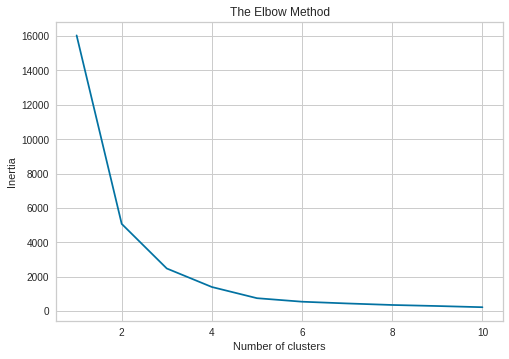

In [67]:
wcss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters = i, init = 'k-means++')
    #kmeans = KMeans(n_clusters = i, init = 'k-means++', random_state = 42)
    kmeans.fit(Coords_clustering)
    wcss.append(kmeans.inertia_)

plt.figure();
plt.plot(range(1, 11), wcss);
plt.title('The Elbow Method');
plt.xlabel('Number of clusters');
plt.ylabel('Inertia');
plt.show();

In [68]:
from sklearn.metrics import silhouette_score

silhouette_coefficients = []
for k in range(2, 11):
  kmeans = KMeans(n_clusters=k,init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0);
  kmeans.fit(Coords_clustering);
  score = silhouette_score(Coords_clustering, kmeans.labels_);
  silhouette_coefficients.append(score);

aux = pd.DataFrame({"K" : range(2, 11),
                    "Silhouette" : silhouette_coefficients})
fig = px.line(aux, x='K', y='Silhouette',labels={'x':'Number of clusters', 'y':'Silhouette'},title="Critère silhouette", markers=True)
fig.show();

### On retient K = 3 classes.

In [69]:
# K = 3
kmeans = KMeans(n_clusters=3).fit(Coords_clustering)

Kmeans_labels = pd.DataFrame({
    "Dim1" : Coords_clustering["Dim1"], 
    "Dim2" : Coords_clustering["Dim2"],
    "Cluster" : pd.Categorical(kmeans.labels_),
    "Traitement" : Coords['Traitement'],
    "Heure" : Coords['Heure'],
    "Replicat" : Coords['Replicat']
})

fig=px.scatter(Kmeans_labels,x="Dim1",y="Dim2",color="Cluster",symbol="Traitement", size="Heure", title="Classification des variables par Kmeans, K=3")
fig.show()

Nous obtenons 3 clusters.

Cluster 1 : Tous les traitements 1.

Cluster 2 : La première heure des traitements 2 & 3.

Cluster 3 : Le reste des traitements 2 & 3.

### Agglomerative clustering : 

In [70]:
from sklearn.cluster import AgglomerativeClustering


KElbowVisualizer(ax=<matplotlib.axes._subplots.AxesSubplot object at 0x7fda1c93afd0>,
                 estimator=AgglomerativeClustering(n_clusters=10), k=(2, 11),
                 metric='calinski_harabasz')

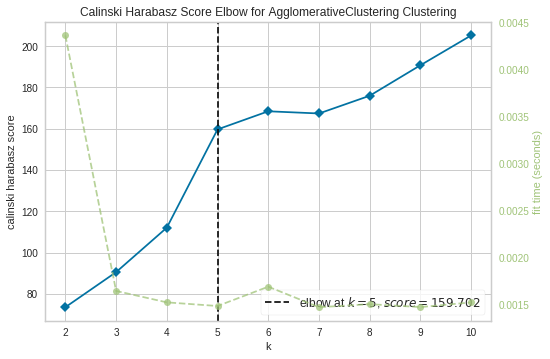

In [71]:
from yellowbrick.cluster import KElbowVisualizer
model = AgglomerativeClustering(linkage="ward")
visualizer = KElbowVisualizer(model, k=(2,11),  metric='calinski_harabasz');
visualizer.fit(Coords_clustering)
visualizer.show()

KElbowVisualizer(ax=<matplotlib.axes._subplots.AxesSubplot object at 0x7fda1c86b0d0>,
                 estimator=AgglomerativeClustering(linkage='single',
                                                   n_clusters=10),
                 k=(2, 11), metric='calinski_harabasz')

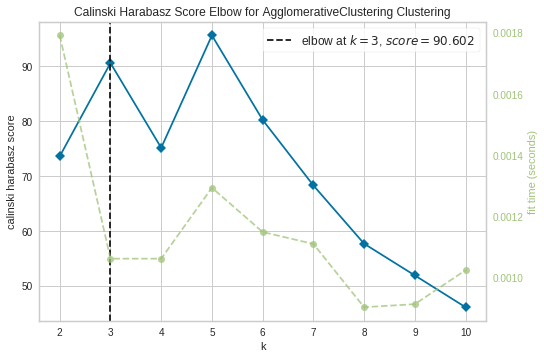

In [72]:
from yellowbrick.cluster import KElbowVisualizer
model = AgglomerativeClustering(linkage="single")
visualizer = KElbowVisualizer(model, k=(2,11),  metric='calinski_harabasz');
visualizer.fit(Coords_clustering)
visualizer.show()

KElbowVisualizer(ax=<matplotlib.axes._subplots.AxesSubplot object at 0x7fda1c87e7d0>,
                 estimator=AgglomerativeClustering(linkage='complete',
                                                   n_clusters=10),
                 k=(2, 11), metric='calinski_harabasz')

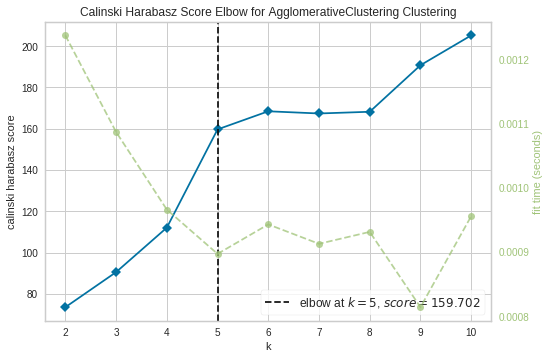

In [73]:
from yellowbrick.cluster import KElbowVisualizer
model = AgglomerativeClustering(linkage="complete")
visualizer = KElbowVisualizer(model, k=(2,11),  metric='calinski_harabasz');
visualizer.fit(Coords_clustering)
visualizer.show()

KElbowVisualizer(ax=<matplotlib.axes._subplots.AxesSubplot object at 0x7fda1c087790>,
                 estimator=AgglomerativeClustering(linkage='average',
                                                   n_clusters=10),
                 k=(2, 11), metric='calinski_harabasz')

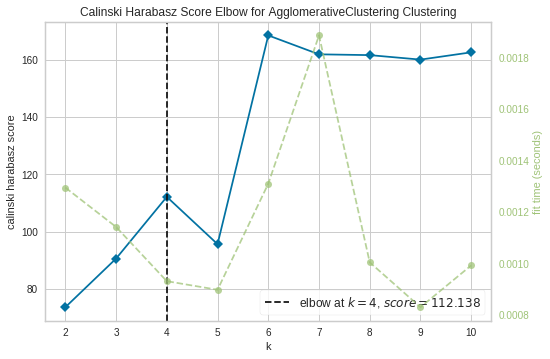

In [74]:
from yellowbrick.cluster import KElbowVisualizer
model = AgglomerativeClustering(linkage="average")
visualizer = KElbowVisualizer(model, k=(2,11),  metric='calinski_harabasz');
visualizer.fit(Coords_clustering)
visualizer.show()

## Argumentation choix méthodes & nombres de classes / mesure d'agrégation.

Avec un très faible nombres d'individus à classer (36, en réalité 18 si on estime que les replicats n'affecte en rien la classification), la méthode des Kmeans, ainsi que la classification hierarchique avec une mesure d'agrégation single semblent plus adaptée. 
Kmeans car générique et s'adapte à un faible nombre de données.

https://scikit-learn.org/stable/auto_examples/cluster/plot_linkage_comparison.html

La mesure d'agrégation single est adaptée à des données avec peu de bruit, non sphérique, ce qui est notre cas. Voir scatter_3D.

Les méthodes basée sur la densité (DBSCAN) ne sont pas adaptées car notre nuage de points est assez dispersé et peu dense.

Sachant que nous souhaitons obtenir une classification des variables, et qu'on a très peu de variables, les mélanges gaussiens ne sont pas adaptés car l'estimation des paramètres va se baser sur peu de données, et vu que nous ne sommes pas interessé par les probabilités d'appartenance aux classes, on peut se passer de cette méthode.


### K = 3 classes, mesure d'agrégation single.

In [75]:
from sklearn.cluster import AgglomerativeClustering # Mesure d'agréagation : Single
hierarchical_cluster = AgglomerativeClustering(n_clusters=3,linkage="single")
Clustk3 = hierarchical_cluster.fit_predict(Coords_clustering)

In [76]:
Hclust3_labels = pd.DataFrame({
    "Dim1" : Coords_clustering["Dim1"], 
    "Dim2" : Coords_clustering["Dim2"],
    "Cluster" : pd.Categorical(Clustk3),
    "Traitement" : Coords['Traitement'],
    "Heure" : Coords['Heure'],
    "Replicat" : Coords['Replicat']
})

fig=px.scatter(Hclust3_labels,x="Dim1",y="Dim2",symbol="Traitement",color="Cluster", size="Heure", title="Classification hiérarchique des variables, K=3, mesure d'agrégation : single.")
fig.show()

Nous obtenons exactement les mêmes clusters.

## Interpretation clusters de variables.

On voit que les gènes du traitements 1, qui forment un cluster de variables, sont en moyenne centrées autour de 0, suivies en module par les gènes du traitement 2 et 3 de la première heure, qui marquent un début de sur-expression / sous-expression, sans pour autant s'éloigner des gènes du traitement 1 en moyenne d'expressions. Ces 4 variables constituent notre second cluster. Enfin, les gènes restantes (Traitements 2 et 3 de 2 à 6h), la sur-expression /sous-expression est clairement distinguable, car en moyenne, les valeurs sont en modules supérieures à 1. C'est notre 3e cluster de variables.

In [77]:
fig_interpretation